# UP 206A Group Assignment 4: Nathan Keibler and Bryan Graveline

For this group assignment, we conducted a spatial autocorrelation analysis using our ADU permit dataset and our census income dataset. Section 2 sets up the data sources using mostly code from Group Assignment 3. Section 3 includes the spatial join to connect our two datasets and some inital mapping of the joined geodataframe. Section 4 contains the meat of the assignment: the spatial autocorrelation analysis itself.

# Data Setup (from Group Assignment 3)

## Research Question

Our research aims to find out if there is a correlation between the median income of a neighborhood and its number of permitted ADUs. Our hypothesis is that the permitting of ADUs will be negatively associated with neighborhood income because neighborhoods with more wealth will be more inclined to resist affordable housing options and maintain their exclusivity.

## Data Sources

We are using two primary types of data sources to tackle this research question. The first type is permit data. This allows us to determine the date and location of each permit pulled to pursue accessory dwelling unit developments. See the first link below for permit data from 2013 to present day for the city of Los Angeles. The second type of data source we are using is American Community Survey income data. The second link below shows income at the census tract level throughout the City of Los Angeles. Lastly, for this assignment, we normalized permit data based on population. The population dataset is shown in the third link below.

- https://bit.ly/2YOtS7j
- https://bit.ly/36KXiaV
- https://bit.ly/2Pysnc7

## Data Download and Brief Exploration

This section shows our data downloads for both datasets as well as a brief summary of the data contained in them. For our full data exploration process, see our Midterm notebooks.

### Library Imports

In [1]:
# to read and wrangle data
import pandas as pd

# to import data from LA Data portal
from sodapy import Socrata

# to create spatial data
import geopandas as gpd

# for basemaps
import contextily as ctx

# For spatial statistics
import esda
from esda.moran import Moran, Moran_Local

import splot
from splot.esda import moran_scatterplot, plot_moran, lisa_cluster,plot_moran_simulation

import libpysal as lps

# Graphics
import matplotlib.pyplot as plt
import plotly.express as px

/opt/conda/lib/python3.8/site-packages/geopandas/_compat.py:106: UserWarning: The Shapely GEOS version (3.8.1-CAPI-1.13.3) is incompatible with the GEOS version PyGEOS was compiled with (3.9.0-CAPI-1.16.2). Conversions between both will be slow.
  warnings.warn(


### Permit Data

The Los Angeles Department of Building and Safety (LADBS) dataset is quite robust; it provides information about *all* permit applications filed with LADBS since early 2013. We used the "# of Accessory Dwelling Units" to filter for just the permits for ADUs. There are just 14,400 entries for 1 or 2 ADUs (the maximum number allowed on a residential plot by state law) in this column; of these, only 8,668 provide geospatial data. We exported these 8,668 as our dataset. Before importing the csv to this notebook, we cleaned the lat/long and issue date columns in excel.

We begin by downloading the data and running a quick .shape and .head(). Then, we'll convert the dataframe to a geodataframe and run an initial plot to make sure our geography is correct.

In [2]:
df = gpd.read_file('data/Building_and_Safety_Permit_Information_Old_cleaned.csv')

In [3]:
df.shape

(8668, 63)

Great! This lets me know that there are 8668 rows and 63 columns. This makes me feel good because I remember when I was downloading the dataset from LADBS, it notified me that there were 8668 rows. 

In [4]:
df.head()

,Assessor Book,Assessor Page,Assessor Parcel,Tract,Block,Lot,Reference # (Old Permit #),PCIS Permit #,Status,Status Date,...,Zone,Occupancy,Floor Area-L.A. Building Code Definition,Census Tract,Council District,Latitude,Longitude,Existing Code,Proposed Code,geometry
0,5069,2,15,TR 4713,,43,20WL05816,19014-10000-05185,Issued,3/10/2020,...,R1R3-RG-O,,115,2169,10,34.04739,-118.36467,7,1,None
1,2276,18,28,TR 5822,,316,19VN04144,19016-20001-12927,Permit Finaled,10/28/2020,...,RE11-1,,0,1413.04,4,34.14947,-118.4565,1,1,None
2,2226,14,6,TR 20444,,6,20ON 1930,20016-10000-19416,Issued,10/27/2020,...,R1-1,,0,1321.02,6,34.20732,-118.49688,1,1,None
3,2637,1,20,TR 14616,,87,19VN92737,19016-20000-10523,CofO Issued,10/31/2020,...,R1-1,,0,1199,6,34.2294,-118.43923,1,1,None
4,5053,24,32,CHA'S VICTOR HALL TRACT,26,21,20ON 1938,20010-10000-02259,Issued,10/27/2020,...,R1R3-O-CPIO,,438,2221,8,34.02655,-118.30291,,1,None


Also feeling good about this one. Latitude and Longitude both have their own columns. I'd like to see all the columns, though, to confirm that the "Issue Year" column I created in Excel shows up.

In [5]:
pd.set_option('display.max_columns', None)
df.head()

,Assessor Book,Assessor Page,Assessor Parcel,Tract,Block,Lot,Reference # (Old Permit #),PCIS Permit #,Status,Status Date,Permit Type,Permit Sub-Type,Permit Category,Project Number,Event Code,Initiating Office,Issue Date,Issue Day,Issue Month,Issue Year,Address Start,Address Fraction Start,Address End,Address Fraction End,Street Direction,Street Name,Street Suffix,Suffix Direction,Unit Range Start,Unit Range End,Zip Code,Work Description,Valuation,Floor Area-L.A. Zoning Code Definition,# of Residential Dwelling Units,# of Accessory Dwelling Units,# of Stories,Contractor's Business Name,Contractor Address,Contractor City,Contractor State,License Type,License #,Principal First Name,Principal Middle Name,Principal Last Name,License Expiration Date,Applicant First Name,Applicant Last Name,Applicant Business Name,Applicant Address 1,Applicant Address 2,Applicant Address 3,Zone,Occupancy,Floor Area-L.A. Building Code Definition,Census Tract,Council District,Latitude,Longitude,Existing Code,Proposed Code,geometry
0,5069,2,15,TR 4713,,43,20WL05816,19014-10000-05185,Issued,3/10/2020,Bldg-Addition,1 or 2 Family Dwelling,Plan Check,,,METRO,3/10/2020,10,3,2020,1563,,1563,,S,GENESEE,AVE,,,,90019,CONVERTING OF (E) GARAGE INTO ACCESSORY DWELLI...,"50,000.00",386,0,1,1,FURER CONSTRUCTION INC,3133 ROBERTS AVE,CULVER CITY,CA,B,988604,HANSPETER,,FURER,11/30/2021,MARC,RAZO,,,,,R1R3-RG-O,,115,2169,10,34.04739,-118.36467,7,1,None
1,2276,18,28,TR 5822,,316,19VN04144,19016-20001-12927,Permit Finaled,10/28/2020,Bldg-Alter/Repair,1 or 2 Family Dwelling,Plan Check,,,VAN NUYS,9/20/2019,20,9,2019,14826,,14826,2-Jan,W,GREENLEAF,ST,,,,91403,Supplemental permit of 19016-20000-12927 to ch...,501,0,0,1,0,OWNER-BUILDER,,,,NA,0,,,,,JACQUELINE,ACOSTA,,6314 VAN NUYS BL.,#212,VAN NUYS CA,RE11-1,,0,1413.04,4,34.14947,-118.4565,1,1,None
2,2226,14,6,TR 20444,,6,20ON 1930,20016-10000-19416,Issued,10/27/2020,Bldg-Alter/Repair,1 or 2 Family Dwelling,Plan Check,,,METRO,10/27/2020,27,10,2020,7527,,7529,,N,RUFFNER,AVE,,,,91406,CONVERSION OF (E) ATTACHED GARAGE TO ACCESSORY...,"50,000.00",360,0,1,1,OWNER-BUILDER,,,,NA,0,,,,1/1/2022,JAVIER,VASQUES,,,,,R1-1,,0,1321.02,6,34.20732,-118.49688,1,1,None
3,2637,1,20,TR 14616,,87,19VN92737,19016-20000-10523,CofO Issued,10/31/2020,Bldg-Alter/Repair,1 or 2 Family Dwelling,Plan Check,,,VAN NUYS,4/29/2019,29,4,2019,8764,,8766,,N,RANCHITO,AVE,,,,91402,CONVERT THE (E) ATTACHED GARAGE INTO A (N) ADU...,"20,000.00",388.5,,1,,OWNER-BUILDER,,,,NA,0,,,,,NOEMI,ESPINO,,,,,R1-1,,0,1199,6,34.2294,-118.43923,1,1,None
4,5053,24,32,CHA'S VICTOR HALL TRACT,26,21,20ON 1938,20010-10000-02259,Issued,10/27/2020,Bldg-New,1 or 2 Family Dwelling,Plan Check,,,METRO,10/27/2020,27,10,2020,3023,,3023,,S,HALLDALE,AVE,,,,90018,NEW DETACHED ACCESSORY DWELLING UNIT PER STATE...,"44,238.00",438,,1,1,SO CAL CONSTRUCTION ENTERPRISES INC,P O BOX 96,SAN GABRIEL,CA,B,832488,GARY,JUAN,URBINA,3/31/2022,RODNEY,REDONDO,,.,.,.,R1R3-O-CPIO,,438,2221,8,34.02655,-118.30291,,1,None


Nice! The "Issue Year" column is showing up.

In [6]:
gdf = gpd.GeoDataFrame(
    df, geometry=gpd.points_from_xy(df.Longitude, df.Latitude))

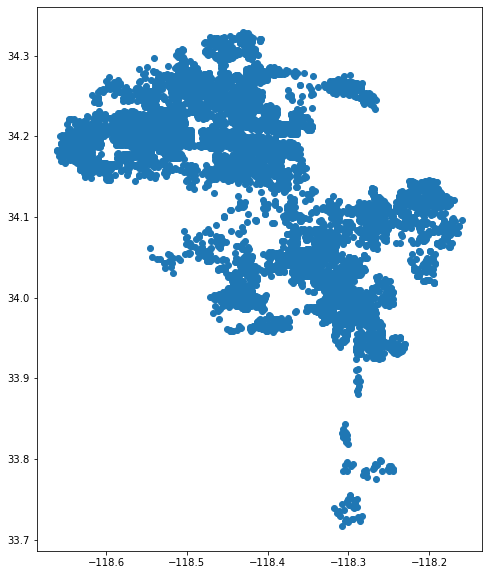

In [7]:
gdf.plot(figsize=(10,10))

Ok looking good! These dots create a shape with an outline that matches that of the City of Los Angeles. 

### Neighborhood Income Data

The data source we downloaded from CensusReporter.org is already clean enough to work with in python. So, we start exploring the data by downloading it and running a quick .head(), .tail(), .shape, .info(), and plotting the data to make sure everything looks right.

In [8]:
gdf_2 = gpd.read_file('data/acs2019_5yr_B19013_14000US06037185320.geojson')
gdf_2.head()

,geoid,name,B19013001,"B19013001, Error",geometry
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",63534.0,16806.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009..."
1,14000US06037101122,"Census Tract 1011.22, Los Angeles, CA",90389.0,9796.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033..."
2,14000US06037101210,"Census Tract 1012.10, Los Angeles, CA",44083.0,9483.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979..."
3,14000US06037101220,"Census Tract 1012.20, Los Angeles, CA",43713.0,4639.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859..."
4,14000US06037101300,"Census Tract 1013, Los Angeles, CA",81776.0,11857.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782..."


In [9]:
gdf_2.tail()

,geoid,name,B19013001,"B19013001, Error",geometry
1000,14000US06037980026,"Census Tract 9800.26, Los Angeles, CA",NaN,NaN,"MULTIPOLYGON (((-118.35173 34.28034, -118.3517..."
1001,14000US06037980028,"Census Tract 9800.28, Los Angeles, CA",NaN,NaN,"MULTIPOLYGON (((-118.45246 33.94315, -118.4464..."
1002,14000US06037980031,"Census Tract 9800.31, Los Angeles, CA",NaN,NaN,"MULTIPOLYGON (((-118.29105 33.75378, -118.2905..."
1003,14000US06037990200,"Census Tract 9902, Los Angeles, CA",NaN,NaN,"MULTIPOLYGON (((-118.63598 34.03255, -118.6325..."
1004,16000US0644000,"Los Angeles, CA",62142.0,452.0,"MULTIPOLYGON (((-118.66818 34.18987, -118.6681..."


In [10]:
gdf_2 = gdf_2.drop([1004])

In [11]:
gdf_2.shape

(1004, 5)

In [12]:
gdf_2.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 1004 entries, 0 to 1003
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   geoid             1004 non-null   object  
 1   name              1004 non-null   object  
 2   B19013001         992 non-null    float64 
 3   B19013001, Error  989 non-null    float64 
 4   geometry          1004 non-null   geometry
dtypes: float64(2), geometry(1), object(2)
memory usage: 47.1+ KB


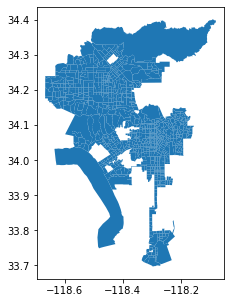

In [13]:
gdf_2.plot(figsize=(5,5))

When we ran .tail(), we noticed that the final row included the entire City of Los Angeles, so we dropped it from the dataset. A .shape() command showed that we have about 1000 rows, which we know to be the approximate number of census tracts in the city. We were initially concerned when we saw lots of NANs in our .head() and .tail(). However, gdf.info() showed that 993 of the 1005 rows have data, and a .info() confirmed that. Finally, our plot shows we have the right geography.

In [14]:
gdf_2.columns = ['geoid','name','median income','error','geometry']
gdf_2.head()

,geoid,name,median income,error,geometry
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",63534.0,16806.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009..."
1,14000US06037101122,"Census Tract 1011.22, Los Angeles, CA",90389.0,9796.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033..."
2,14000US06037101210,"Census Tract 1012.10, Los Angeles, CA",44083.0,9483.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979..."
3,14000US06037101220,"Census Tract 1012.20, Los Angeles, CA",43713.0,4639.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859..."
4,14000US06037101300,"Census Tract 1013, Los Angeles, CA",81776.0,11857.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782..."


We then cleaned the column names so it's more apparent what we're looking at.

For group assignment 4, we wish to normalize the permit data by population. But, the neighborhood income dataset we brought in does not include population. So, I'll join population data to the census tract data here.

In [15]:
gdf_3 = gpd.read_file('data/acs2019_5yr_B01003_14000US06037208802.geojson')
gdf_3.head()

,geoid,name,B01003001,"B01003001, Error",geometry
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",4283.0,443.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009..."
1,14000US06037101122,"Census Tract 1011.22, Los Angeles, CA",3405.0,334.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033..."
2,14000US06037101210,"Census Tract 1012.10, Los Angeles, CA",6347.0,484.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979..."
3,14000US06037101220,"Census Tract 1012.20, Los Angeles, CA",3702.0,276.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859..."
4,14000US06037101300,"Census Tract 1013, Los Angeles, CA",3884.0,394.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782..."


There's our dataset, again downloaded from censusreporter.org. Similar to the neighborhood income data, we see that the last row is a summary of the entire city, so we remove it. We then rename the columns to a similar format as the neighborhood income data.

In [16]:
gdf_3 = gdf_3.drop([1004])
gdf_3.tail()

,geoid,name,B01003001,"B01003001, Error",geometry
999,14000US06037980024,"Census Tract 9800.24, Los Angeles, CA",223.0,75.0,"MULTIPOLYGON (((-118.51849 34.18389, -118.5184..."
1000,14000US06037980026,"Census Tract 9800.26, Los Angeles, CA",26.0,18.0,"MULTIPOLYGON (((-118.35173 34.28034, -118.3517..."
1001,14000US06037980028,"Census Tract 9800.28, Los Angeles, CA",0.0,12.0,"MULTIPOLYGON (((-118.45246 33.94315, -118.4464..."
1002,14000US06037980031,"Census Tract 9800.31, Los Angeles, CA",1175.0,178.0,"MULTIPOLYGON (((-118.29105 33.75378, -118.2905..."
1003,14000US06037990200,"Census Tract 9902, Los Angeles, CA",0.0,12.0,"MULTIPOLYGON (((-118.63598 34.03255, -118.6325..."


In [17]:
gdf_3.columns = ['geoid','name','population','poperror','geometry']
gdf_3.head()

,geoid,name,population,poperror,geometry
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",4283.0,443.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009..."
1,14000US06037101122,"Census Tract 1011.22, Los Angeles, CA",3405.0,334.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033..."
2,14000US06037101210,"Census Tract 1012.10, Los Angeles, CA",6347.0,484.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979..."
3,14000US06037101220,"Census Tract 1012.20, Los Angeles, CA",3702.0,276.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859..."
4,14000US06037101300,"Census Tract 1013, Los Angeles, CA",3884.0,394.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782..."


In [18]:
gdf_2 = pd.merge(gdf_2, gdf_3, on=['geoid','name','geometry'])
gdf_2.head()

,geoid,name,median income,error,geometry,population,poperror
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",63534.0,16806.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009...",4283.0,443.0
1,14000US06037101122,"Census Tract 1011.22, Los Angeles, CA",90389.0,9796.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033...",3405.0,334.0
2,14000US06037101210,"Census Tract 1012.10, Los Angeles, CA",44083.0,9483.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979...",6347.0,484.0
3,14000US06037101220,"Census Tract 1012.20, Los Angeles, CA",43713.0,4639.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859...",3702.0,276.0
4,14000US06037101300,"Census Tract 1013, Los Angeles, CA",81776.0,11857.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782...",3884.0,394.0


Great! Our neighborhood income dataset, which initially only included median income, now includes population. We'll use this later.

## Data Analysis and Visualizations

In the sections below, we proceed with analysis of our two data sources (permit data and neighborhood income data) and create charts and plots to visualize the data.

### Permit Data

Next we define the geodataframe as CRS so Python knows this is spatial. Then we convert to Web Mercator so contextily can place the data properly. 

In [19]:
gdf.set_crs(epsg=4326, inplace=True)

,Assessor Book,Assessor Page,Assessor Parcel,Tract,Block,Lot,Reference # (Old Permit #),PCIS Permit #,Status,Status Date,Permit Type,Permit Sub-Type,Permit Category,Project Number,Event Code,Initiating Office,Issue Date,Issue Day,Issue Month,Issue Year,Address Start,Address Fraction Start,Address End,Address Fraction End,Street Direction,Street Name,Street Suffix,Suffix Direction,Unit Range Start,Unit Range End,Zip Code,Work Description,Valuation,Floor Area-L.A. Zoning Code Definition,# of Residential Dwelling Units,# of Accessory Dwelling Units,# of Stories,Contractor's Business Name,Contractor Address,Contractor City,Contractor State,License Type,License #,Principal First Name,Principal Middle Name,Principal Last Name,License Expiration Date,Applicant First Name,Applicant Last Name,Applicant Business Name,Applicant Address 1,Applicant Address 2,Applicant Address 3,Zone,Occupancy,Floor Area-L.A. Building Code Definition,Census Tract,Council District,Latitude,Longitude,Existing Code,Proposed Code,geometry
0,5069,2,15,TR 4713,,43,20WL05816,19014-10000-05185,Issued,3/10/2020,Bldg-Addition,1 or 2 Family Dwelling,Plan Check,,,METRO,3/10/2020,10,3,2020,1563,,1563,,S,GENESEE,AVE,,,,90019,CONVERTING OF (E) GARAGE INTO ACCESSORY DWELLI...,"50,000.00",386,0,1,1,FURER CONSTRUCTION INC,3133 ROBERTS AVE,CULVER CITY,CA,B,988604,HANSPETER,,FURER,11/30/2021,MARC,RAZO,,,,,R1R3-RG-O,,115,2169,10,34.04739,-118.36467,7,1,POINT (-118.36467 34.04739)
1,2276,18,28,TR 5822,,316,19VN04144,19016-20001-12927,Permit Finaled,10/28/2020,Bldg-Alter/Repair,1 or 2 Family Dwelling,Plan Check,,,VAN NUYS,9/20/2019,20,9,2019,14826,,14826,2-Jan,W,GREENLEAF,ST,,,,91403,Supplemental permit of 19016-20000-12927 to ch...,501,0,0,1,0,OWNER-BUILDER,,,,NA,0,,,,,JACQUELINE,ACOSTA,,6314 VAN NUYS BL.,#212,VAN NUYS CA,RE11-1,,0,1413.04,4,34.14947,-118.4565,1,1,POINT (-118.45650 34.14947)
2,2226,14,6,TR 20444,,6,20ON 1930,20016-10000-19416,Issued,10/27/2020,Bldg-Alter/Repair,1 or 2 Family Dwelling,Plan Check,,,METRO,10/27/2020,27,10,2020,7527,,7529,,N,RUFFNER,AVE,,,,91406,CONVERSION OF (E) ATTACHED GARAGE TO ACCESSORY...,"50,000.00",360,0,1,1,OWNER-BUILDER,,,,NA,0,,,,1/1/2022,JAVIER,VASQUES,,,,,R1-1,,0,1321.02,6,34.20732,-118.49688,1,1,POINT (-118.49688 34.20732)
3,2637,1,20,TR 14616,,87,19VN92737,19016-20000-10523,CofO Issued,10/31/2020,Bldg-Alter/Repair,1 or 2 Family Dwelling,Plan Check,,,VAN NUYS,4/29/2019,29,4,2019,8764,,8766,,N,RANCHITO,AVE,,,,91402,CONVERT THE (E) ATTACHED GARAGE INTO A (N) ADU...,"20,000.00",388.5,,1,,OWNER-BUILDER,,,,NA,0,,,,,NOEMI,ESPINO,,,,,R1-1,,0,1199,6,34.2294,-118.43923,1,1,POINT (-118.43923 34.22940)
4,5053,24,32,CHA'S VICTOR HALL TRACT,26,21,20ON 1938,20010-10000-02259,Issued,10/27/2020,Bldg-New,1 or 2 Family Dwelling,Plan Check,,,METRO,10/27/2020,27,10,2020,3023,,3023,,S,HALLDALE,AVE,,,,90018,NEW DETACHED ACCESSORY DWELLING UNIT PER STATE...,"44,238.00",438,,1,1,SO CAL CONSTRUCTION ENTERPRISES INC,P O BOX 96,SAN GABRIEL,CA,B,832488,GARY,JUAN,URBINA,3/31/2022,RODNEY,REDONDO,,.,.,.,R1R3-O-CPIO,,438,2221,8,34.02655,-118.30291,,1,POINT (-118.30291 34.02655)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8663,6031,31,11,SUNSET SQUARE,,20,19SL68122,19010-10000-00417,Issued,10/21/2019,Bldg-New,1 or 2 Family Dwelling,Plan Check,,,METRO,10/21/2019,21,10,2019,146,,146,,W,82ND,ST,,,,90003,NEW TWO STORY DEATACHED ADU PER AB 229 AND AB ...,"109,888.00","1,088",,1,2,OWNER-BUILDER,,,,NA,0,,,,,GEORGE,CORRALES,,,,,R2-1,,"1,088",2397.01,9,33.9649,-118.27552,,1,POINT (-118.27552 33.96490)
8664,2346,20,2,TR 11715,,2,19VN01880,19016-20000-04281,Issued,8/22/2019,Bldg-Alter/Repair,1 or 2 Family Dwelling,Plan Check,,,VAN NUYS,8/22/2019,22,8,2019,5344,,5344,,N,BELLAIRE,AVE,,,,91607,CONVERT ATTACHED GARAGE TO ACCESSORY DWELLING ...,"36,500.00",771,0,1,0,OWNER-BU

In [20]:
gdf_web_mercator = gdf.to_crs(epsg=3857)

Now I will plot the geodataframe onto a basemap.

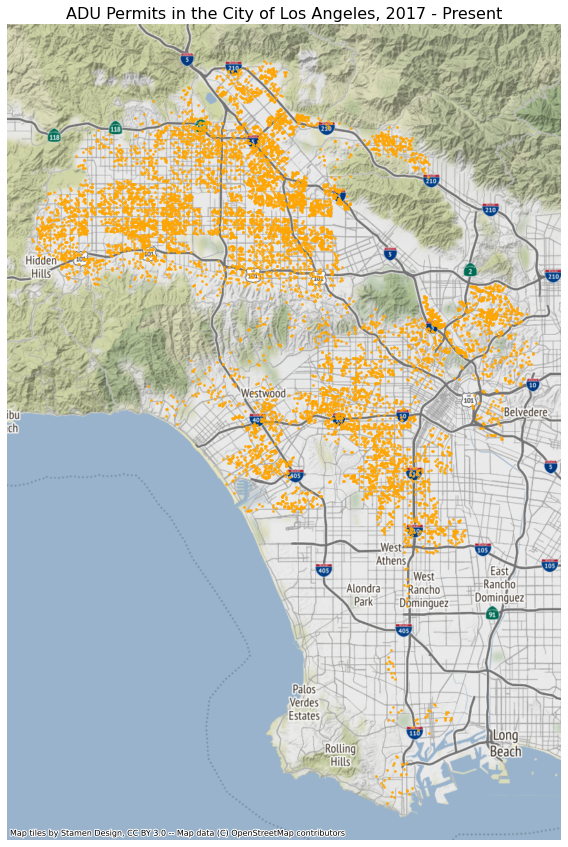

In [21]:
fig, ax = plt.subplots(figsize=(15, 15))

gdf_web_mercator.plot(ax=ax, alpha=0.8, markersize=3, color='orange')

ax.axis('off')

ax.set_title('ADU Permits in the City of Los Angeles, 2017 - Present',fontsize=16)

ctx.add_basemap(ax)

Yay! Looking good. 

Now I'll use the new library I uploaded, "plotly.express," to create some bar charts with the permit dataset. First, I will attempt to create one that shows "Issue Year" on the x-axis and "Number of Permits Issued" on the y-axis. I'm glad I cleaned the excel spreadsheet before uploading so that year has its own column. This will make my bar chart more legible.

In [22]:
fig = px.bar(df,
       x='Issue Year',
       title='ADU Permits Issued in the City of Los Angeles by Year',
       labels={'Issue Year':'Issue Year','count':'Number of Permits Issued'}
      )
fig.update_traces(marker_line_width=0)

Sweet. It looks like 2019 was a big year for ADU permits. A couple takeaways below: 

- It's interesting that the dataset includes no information on permits filed before 2017. This makes sense, I suppose, considering all the new state legislation that made ADU development easier took effect in early 2017. Since the LADBS website told me that the permit data went as far back as 2013, I find it hard to believe that *zero* ADU permits were filed between 2013 and 2017, but maybe these permits were not captured because they did not input any latitudinal or longitudinal information. 
- It's also interesting to note the significant decrease in number of permits filed in 2020 compared to 2019. My guess is that Covid caused homeowners to rethink their financial plans. I'm also thinking that the shift to working virtually caused the development process to slow down quite a bit. My understanding is that drawing sets delivered to the city for review have to sit for two weeks before a city employee will look them over. But, I also thought that ADU permit applications were allowed to use the city's e-file process... I'll have to look more into this.

Now I'd like to create some stacked bar charts that specifically considering the following columns in our permit dataset: 
 
- Status: The status of a permit can range from "approved" to "issued" to "certificate of occupancy issued." The latter is largely considered to be one of the final steps in the construction process. This document certifies that the property that has recently been constructed or converted complies with all building codes while also being fit for occupancy by a business or individual.
- Initiating Office: LADBS has five different offices throughout the city: Metro, Van Nuys, West LA, South LA, and San Pedro. I'm curious to see if a certain office is handling more ADU permits than others.
- Zip Code

In [23]:
# show me distinct value of charges
# outputting list of unique values in a column
df.Status.unique().tolist()

['Issued',
 'Permit Finaled',
 'CofO Issued',
 'CofO in Progress',
 'Re-Activate Permit',
 'Refund Completed',
 'CofO Corrected',
 'Permit Expired',
 'Permit Closed',
 'Permit Withdrawn',
 'Refund in Progress',
 'Approved']

In [24]:
# show me distinct value of permits
# value count returns series, reset_index converts series to dataframe, which we are more comfortable with
permit_by_status = df.Status.value_counts().reset_index()
permit_by_status.columns=['Permit Status','Count']
permit_by_status

,Permit Status,Count
0,CofO Issued,4571
1,Issued,3296
2,CofO in Progress,476
3,Permit Finaled,210
4,CofO Corrected,40
5,Re-Activate Permit,26
6,Refund Completed,26
7,Permit Expired,11
8,Permit Closed,5
9,Permit Withdrawn,3


In [25]:
# show me how many of each permit status type
# returning every single column and how many records are not null
df.groupby(['Status']).count()

,Assessor Book,Assessor Page,Assessor Parcel,Tract,Block,Lot,Reference # (Old Permit #),PCIS Permit #,Status Date,Permit Type,Permit Sub-Type,Permit Category,Project Number,Event Code,Initiating Office,Issue Date,Issue Day,Issue Month,Issue Year,Address Start,Address Fraction Start,Address End,Address Fraction End,Street Direction,Street Name,Street Suffix,Suffix Direction,Unit Range Start,Unit Range End,Zip Code,Work Description,Valuation,Floor Area-L.A. Zoning Code Definition,# of Residential Dwelling Units,# of Accessory Dwelling Units,# of Stories,Contractor's Business Name,Contractor Address,Contractor City,Contractor State,License Type,License #,Principal First Name,Principal Middle Name,Principal Last Name,License Expiration Date,Applicant First Name,Applicant Last Name,Applicant Business Name,Applicant Address 1,Applicant Address 2,Applicant Address 3,Zone,Occupancy,Floor Area-L.A. Building Code Definition,Census Tract,Council District,Latitude,Longitude,Existing Code,Proposed Code,geometry
Status,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Approved,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
CofO Corrected,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40,40
CofO Issued,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571,4571
CofO in Progress,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476,476
Issued,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296,3296
Permit Closed,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5
Permit Expired,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11
Permit Finaled,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210,210
Permit Withdrawn,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3


In [26]:
# ok, group by issue year and status, and let's get a count for each
df_grouped=df.groupby(['Issue Year','Status']).count()[['Assessor Book']]
df_grouped.head(50)

Assessor Book
Issue Year Status                           
2017       CofO Corrected                  9
           CofO Issued                   803
           CofO in Progress               29
           Issued                        177
           Permit Closed                   1
           Permit Expired                  6
           Permit Finaled                 43
           Re-Activate Permit              5
           Refund Completed                6
2018       CofO Corrected                 15
           CofO Issued                  1761
           CofO in Progress              109
           Issued                        585
           Permit Closed                   1
           Permit Expired                  4
           Permit Finaled                 62
           Permit Withdrawn                1
           Re-Activate Permit             13
           Refund Completed               13
2019       CofO Corrected                 12
           CofO Issued                  1592
           CofO in Progress              218
           Issued                       1005
           Permit Closed                   3
           Permit Expired                  1
           Permit Finaled                 70
           Permit Withdrawn                1
           Re-Activate Permit              8
           Refund Completed                7
2020       Approved                        1
           CofO Corrected                  4
           CofO Issued                   415
           CofO in Progress              119
           Issued                       1404
           Permit Finaled                 34
           Permit Withdrawn                1
           Refund in Progress              3
2021       CofO in Progress                1
           Issued                        125
           Permit Finaled                  1

In [27]:
# flatten the multi-index, multi-level dataframe
df_flat = df_grouped.reset_index()
df_flat

,Issue Year,Status,Assessor Book
0,2017,CofO Corrected,9
1,2017,CofO Issued,803
2,2017,CofO in Progress,29
3,2017,Issued,177
4,2017,Permit Closed,1
5,2017,Permit Expired,6
6,2017,Permit Finaled,43
7,2017,Re-Activate Permit,5
8,2017,Refund Completed,6
9,2018,CofO Corrected,15


In [28]:
# rename the rpt_id column to count
df_flat = df_flat.rename(columns={'Assessor Book':'Count'})

In [29]:
fig = px.bar(df_flat,
       x='Issue Year',
       y='Count',
       title='ADU Permits Issued in the City of Los Angeles by Permit Status and Year',
       labels={'Count':'Number of Permits Issued'},
       color='Status' # this creates the "stack"
      )
fig.update_traces(marker_line_width=0)

In [30]:
df.columns = ['Assessor Book', 'Assessor Page', 'Assessor Parcel', 'Tract', 'Block',
       'Lot', 'Reference # (Old Permit #)', 'PCIS Permit #', 'Status',
       'Status Date', 'Permit Type', 'Permit Sub-Type', 'Permit Category',
       'Project Number', 'Event Code', 'initiating_office', 'Issue Date',
       'Issue Day', 'Issue Month', 'Issue Year', 'Address Start',
       'Address Fraction Start', 'Address End', 'Address Fraction End',
       'Street Direction', 'Street Name', 'Street Suffix', 'Suffix Direction',
       'Unit Range Start', 'Unit Range End', 'Zip_Code', 'Work Description',
       'Valuation', 'Floor Area-L.A. Zoning Code Definition',
       '# of Residential Dwelling Units', '# of Accessory Dwelling Units',
       '# of Stories', 'Contractors_Business_Name', 'Contractor Address',
       'Contractor City', 'Contractor State', 'License Type', 'License #',
       'Principal First Name', 'Principal Middle Name', 'Principal Last Name',
       'License Expiration Date', 'Applicant First Name',
       'Applicant Last Name', 'Applicant Business Name', 'Applicant Address 1',
       'Applicant Address 2', 'Applicant Address 3', 'Zone', 'Occupancy',
       'Floor Area-L.A. Building Code Definition', 'Census Tract',
       'Council District', 'Latitude', 'Longitude', 'Existing Code',
       'Proposed Code', 'geometry']

In [31]:
fig = px.bar(df,
       x='initiating_office',
       title='ADU Permits Issued in the City of Los Angeles by Initiating Office',
       labels={'initiating_office':'Initiating Office','count':'Number of Permits Issued'}
      )
fig.update_traces(marker_line_width=0)

In [32]:
# show me distinct value of charges
# outputting list of unique values in a column
df.initiating_office.unique().tolist()

['METRO', 'VAN NUYS', 'SOUTH LA', 'WEST LA', 'SANPEDRO']

In [33]:
# show me distinct value of charges
# value count returns series, reset_index converts series to dataframe, which we are more comfortable with
permit_by_office = df.initiating_office.value_counts().reset_index()
permit_by_office.columns=['Office','Count']
permit_by_office

,Office,Count
0,VAN NUYS,5679
1,METRO,1870
2,WEST LA,691
3,SOUTH LA,362
4,SANPEDRO,66


In [34]:
df.groupby(['initiating_office']).count()

,Assessor Book,Assessor Page,Assessor Parcel,Tract,Block,Lot,Reference # (Old Permit #),PCIS Permit #,Status,Status Date,Permit Type,Permit Sub-Type,Permit Category,Project Number,Event Code,Issue Date,Issue Day,Issue Month,Issue Year,Address Start,Address Fraction Start,Address End,Address Fraction End,Street Direction,Street Name,Street Suffix,Suffix Direction,Unit Range Start,Unit Range End,Zip_Code,Work Description,Valuation,Floor Area-L.A. Zoning Code Definition,# of Residential Dwelling Units,# of Accessory Dwelling Units,# of Stories,Contractors_Business_Name,Contractor Address,Contractor City,Contractor State,License Type,License #,Principal First Name,Principal Middle Name,Principal Last Name,License Expiration Date,Applicant First Name,Applicant Last Name,Applicant Business Name,Applicant Address 1,Applicant Address 2,Applicant Address 3,Zone,Occupancy,Floor Area-L.A. Building Code Definition,Census Tract,Council District,Latitude,Longitude,Existing Code,Proposed Code,geometry
initiating_office,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
METRO,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870,1870
SANPEDRO,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66,66
SOUTH LA,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362,362
VAN NUYS,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679,5679
WEST LA,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691,691


In [35]:
# ok, group by issue year and status, and let's get a count for each
df_grouped_2=df.groupby(['Issue Year','initiating_office']).count()[['Assessor Book']]
df_grouped_2.head(50)

Assessor Book
Issue Year initiating_office               
2017       METRO                        232
           SANPEDRO                       6
           SOUTH LA                      44
           VAN NUYS                     689
           WEST LA                      108
2018       METRO                        520
           SANPEDRO                      20
           SOUTH LA                     143
           VAN NUYS                    1661
           WEST LA                      220
2019       METRO                        533
           SANPEDRO                      27
           SOUTH LA                     121
           VAN NUYS                    2025
           WEST LA                      211
2020       METRO                        531
           SANPEDRO                      13
           SOUTH LA                      53
           VAN NUYS                    1239
           WEST LA                      145
2021       METRO                         54
           SOUTH LA                       1
           VAN NUYS                      65
           WEST LA                        7

In [36]:
# flatten the multi-index, multi-level dataframe
df_flat_2 = df_grouped_2.reset_index()
df_flat_2

,Issue Year,initiating_office,Assessor Book
0,2017,METRO,232
1,2017,SANPEDRO,6
2,2017,SOUTH LA,44
3,2017,VAN NUYS,689
4,2017,WEST LA,108
5,2018,METRO,520
6,2018,SANPEDRO,20
7,2018,SOUTH LA,143
8,2018,VAN NUYS,1661
9,2018,WEST LA,220


In [37]:
# rename the rpt_id column to count
df_flat_2 = df_flat_2.rename(columns={'Assessor Book':'Number of Permits Issued'})

In [38]:
fig = px.bar(df_flat_2,
       x='Issue Year',
       y='Number of Permits Issued',
       title='ADU Permits Issued in the City of Los Angeles by Initiating Office and Year',
       color='initiating_office',
       labels={'initiating_office':'Initiating Office'}
      )
fig.update_traces(marker_line_width=0)

In [39]:
fig = px.bar(df,
       x='Zip_Code',
       title='ADU Permits Issued in the City of Los Angeles by Zip Code',
       labels={'count':'Number of Permits Issued'}
      )
fig.update_traces(marker_line_width=0)

In [40]:
# show me distinct value of charges
# outputting list of unique values in a column
df.Zip_Code.unique().tolist()

['90019',
 '91403',
 '91406',
 '91402',
 '90018',
 '90002',
 '90062',
 '90066',
 '91342',
 '90035',
 '91411',
 '91325',
 '90031',
 '90064',
 '91344',
 '90007',
 '91604',
 '90029',
 '91326',
 '90049',
 '91306',
 '91607',
 '90004',
 '91307',
 '90501',
 '90016',
 '90048',
 '90023',
 '90006',
 '91331',
 '90731',
 '91367',
 '90025',
 '90011',
 '90037',
 '90032',
 '90034',
 '91436',
 '91335',
 '90065',
 '91345',
 '91324',
 '90026',
 '90041',
 '90045',
 '90210',
 '91042',
 '91401',
 '90043',
 '91606',
 '91405',
 '90042',
 '91423',
 '90027',
 '90047',
 '91605',
 '90039',
 '90008',
 '91340',
 '91304',
 '91356',
 '90744',
 '90046',
 '90038',
 '90247',
 '90033',
 '91343',
 '90068',
 '91505',
 '90028',
 '91364',
 '90003',
 '90291',
 '90059',
 '91303',
 '90069',
 '90024',
 '90044',
 '90063',
 '91602',
 '90402',
 '91352',
 '90061',
 '90020',
 '91601',
 '90292',
 '90732',
 '90036',
 '91504',
 '90230',
 '90272',
 '91040',
 '91316',
 '91311',
 '90077',
 '90293',
 '90710',
 '90057',
 '90001',
 '90005',


In [41]:
# show me distinct value of charges
# value count returns series, reset_index converts series to dataframe, which we are more comfortable with
permit_by_zip = df.Zip_Code.value_counts().reset_index()
permit_by_zip.columns=['Zip Code','Count']
permit_by_zip

,Zip Code,Count
0,91331,457
1,91335,433
2,91342,301
3,91605,294
4,91344,263
...,...,...
100,91214,2
101,90056,2
102,90248,1
103,90402,1


In [42]:
df.groupby(['Zip_Code']).count()

,Assessor Book,Assessor Page,Assessor Parcel,Tract,Block,Lot,Reference # (Old Permit #),PCIS Permit #,Status,Status Date,Permit Type,Permit Sub-Type,Permit Category,Project Number,Event Code,initiating_office,Issue Date,Issue Day,Issue Month,Issue Year,Address Start,Address Fraction Start,Address End,Address Fraction End,Street Direction,Street Name,Street Suffix,Suffix Direction,Unit Range Start,Unit Range End,Work Description,Valuation,Floor Area-L.A. Zoning Code Definition,# of Residential Dwelling Units,# of Accessory Dwelling Units,# of Stories,Contractors_Business_Name,Contractor Address,Contractor City,Contractor State,License Type,License #,Principal First Name,Principal Middle Name,Principal Last Name,License Expiration Date,Applicant First Name,Applicant Last Name,Applicant Business Name,Applicant Address 1,Applicant Address 2,Applicant Address 3,Zone,Occupancy,Floor Area-L.A. Building Code Definition,Census Tract,Council District,Latitude,Longitude,Existing Code,Proposed Code,geometry
Zip_Code,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
90001,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8
90002,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73
90003,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81,81
90004,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91602,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33
91604,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59
91605,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294,294


In [43]:
# ok, group by issue year and status, and let's get a count for each
df_grouped_3=df.groupby(['Issue Year','Zip_Code']).count()[['Assessor Book']]
df_grouped_3.head(50)

Assessor Book
Issue Year Zip_Code               
2017       90001                 2
           90002                 7
           90003                 8
           90004                16
           90005                 1
           90006                 4
           90007                 4
           90008                 3
           90011                 9
           90012                 1
           90016                20
           90018                 5
           90019                25
           90020                 3
           90023                 2
           90024                 4
           90025                 2
           90026                 6
           90027                 4
           90029                 2
           90031                 4
           90032                 6
           90033                 2
           90034                11
           90035                11
           90036                 9
           90037                 7
           90038                 1
           90039                18
           90041                 9
           90042                21
           90043                 6
           90044                12
           90045                 5
           90046                 9
           90047                11
           90048                 6
           90049                 8
           90059                 2
           90062                10
           90063                 1
           90064                13
           90065                17
           90066                34
           90068                 4
           90069                 3
           90077                 1
           90210                 5
           90230                 9
           90247                 1

In [44]:
# flatten the multi-index, multi-level dataframe
df_flat_3 = df_grouped_3.reset_index()
df_flat_3

,Issue Year,Zip_Code,Assessor Book
0,2017,90001,2
1,2017,90002,7
2,2017,90003,8
3,2017,90004,16
4,2017,90005,1
...,...,...,...
447,2021,91436,1
448,2021,91601,3
449,2021,91605,4
450,2021,91606,1


In [45]:
# rename the rpt_id column to count
df_flat_3 = df_flat_3.rename(columns={'Assessor Book':'Number of Permits Issued'})

In [46]:
fig = px.bar(df_flat_3,
       x='Issue Year',
       y='Number of Permits Issued',
       title='ADU Permits Issued in the City of Los Angeles by Zip Code and Year',
       color='Zip_Code',
       labels={'Zip_Code':'Zip Code'}
      )
fig.update_traces(marker_line_width=0)

Great! These stacked barcharts have been a really helpful set of exercises for us to start to analyze the permit dataset. Some of the main takeaways below: 

- In 2020, the number of "Issued" permits was much larger in comparison to the Certificates of Occupancy issued. This deviates from the historical patterns that we see in 2017, 2018, and 2019, where more Certificates of Occupancy are issued in comparison ot "Issued" permits. This is likely due to Covid. It's unfortunate to see that not as many completed ADUs are receiving the necessary documents for residents to occupy them. 
- The Van Nuys permit office has been very busy! It's interesting to see that the majority of ADU permits are being filed with this office. 
- There are a couple zip codes that are filing a much larger number of ADU permits in comparison to others. 91331, 91335, 91342, and 91605 are standouts. 

Now I will attempt to create a couple interactive maps. I am very excited for this portion as it will finally give us a chance to zoom in to a finer level of detail on the permit data. First, I'll look at the dataset to see which columns I'd like to focus on.

In [47]:
df.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 8668 entries, 0 to 8667
Data columns (total 63 columns):
 #   Column                                    Non-Null Count  Dtype   
---  ------                                    --------------  -----   
 0   Assessor Book                             8668 non-null   object  
 1   Assessor Page                             8668 non-null   object  
 2   Assessor Parcel                           8668 non-null   object  
 3   Tract                                     8668 non-null   object  
 4   Block                                     8668 non-null   object  
 5   Lot                                       8668 non-null   object  
 6   Reference # (Old Permit #)                8668 non-null   object  
 7   PCIS Permit #                             8668 non-null   object  
 8   Status                                    8668 non-null   object  
 9   Status Date                               8668 non-null   object  
 10  Permit Type     

Next, I'll create a smaller dataframe "df_mini" and only focus on the following columns: Status, Initiating Office, Issue Year, Zip Code, Work Description, # of Accessory Dwelling Units, Latitude and Longitude.

In [48]:
# subset the data below (don't forget to add .copy at the end)
df_mini = df[['Status','initiating_office','Issue Year','Zip_Code','Work Description','# of Accessory Dwelling Units','Latitude','Longitude']].copy()
df_mini

,Status,initiating_office,Issue Year,Zip_Code,Work Description,# of Accessory Dwelling Units,Latitude,Longitude
0,Issued,METRO,2020,90019,CONVERTING OF (E) GARAGE INTO ACCESSORY DWELLI...,1,34.04739,-118.36467
1,Permit Finaled,VAN NUYS,2019,91403,Supplemental permit of 19016-20000-12927 to ch...,1,34.14947,-118.4565
2,Issued,METRO,2020,91406,CONVERSION OF (E) ATTACHED GARAGE TO ACCESSORY...,1,34.20732,-118.49688
3,CofO Issued,VAN NUYS,2019,91402,CONVERT THE (E) ATTACHED GARAGE INTO A (N) ADU...,1,34.2294,-118.43923
4,Issued,METRO,2020,90018,NEW DETACHED ACCESSORY DWELLING UNIT PER STATE...,1,34.02655,-118.30291
...,...,...,...,...,...,...,...,...
8663,Issued,METRO,2019,90003,NEW TWO STORY DEATACHED ADU PER AB 229 AND AB ...,1,33.9649,-118.27552
8664,Issued,VAN NUYS,2019,91607,CONVERT ATTACHED GARAGE TO ACCESSORY DWELLING ...,1,34.16792,-118.40928
8665,CofO Issued,VAN NUYS,2019,91364,"NEW 26'-0""X24'-0"", MAX HEIGHT 22'-5"" 2-STORY ...",1,34.15856,-118.59564
8666,Issued,VAN NUYS,2020,91606,"CONVERT (E) 18'-6"" X 20'-0"" DETACHED GARAGE AN...",1,34.18136,-118.37113


In [49]:
# get info for our subset data
df_mini.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8668 entries, 0 to 8667
Data columns (total 8 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   Status                         8668 non-null   object
 1   initiating_office              8668 non-null   object
 2   Issue Year                     8668 non-null   object
 3   Zip_Code                       8668 non-null   object
 4   Work Description               8668 non-null   object
 5   # of Accessory Dwelling Units  8668 non-null   object
 6   Latitude                       8668 non-null   object
 7   Longitude                      8668 non-null   object
dtypes: object(8)
memory usage: 541.9+ KB


Next, I will convert the latitude and longitude columns to floats.

In [50]:
# convert lat/lon's to floats
df_mini['Latitude'] = df_mini['Latitude'].astype(float)
df_mini['Longitude'] = df_mini['Longitude'].astype(float)
df_mini.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8668 entries, 0 to 8667
Data columns (total 8 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   Status                         8668 non-null   object 
 1   initiating_office              8668 non-null   object 
 2   Issue Year                     8668 non-null   object 
 3   Zip_Code                       8668 non-null   object 
 4   Work Description               8668 non-null   object 
 5   # of Accessory Dwelling Units  8668 non-null   object 
 6   Latitude                       8668 non-null   float64
 7   Longitude                      8668 non-null   float64
dtypes: float64(2), object(6)
memory usage: 541.9+ KB


Time to plot! I'll try that below.

In [51]:
px.scatter(df_mini,
           x='Longitude',
           y='Latitude'
          )

In [52]:
fig = px.scatter_mapbox(df_mini,
                        lat='Latitude',
                        lon='Longitude',
                        mapbox_style="stamen-terrain")
fig.show()

Great! It's so exciting to be able to zoom in! Now I'll create an interactive map that assigns a different color to each zip code. I'll use a darker basemap so that the colors pop and are more legible.

In [53]:
fig = px.scatter_mapbox(df_mini, 
                        lat="Latitude", 
                        lon="Longitude", 
                        color="Zip_Code",
                       )

fig.update_layout(mapbox_style="carto-darkmatter")

fig.show()

Sweet! We can now see that 91331, 91335, 91342, and 91605 (standout zip codes we mentioned earlier) are all concentrated in various parts of the San Fernando Valley.

### Neighborhood Income Data

First, I'd like to create a chart showing how many neighborhoods have various levels of median income to get a sense of the distribution. My guess is that there will be a lot of census tracts towards the lower end of the spectrum with some outliers towards the upper end of the spectrum.

In [54]:
fig = px.bar(gdf_2,
      y='median income',
      title='Median Income by Neighborhood')
fig.update_traces(marker_line_width=0)

This didn't quite do what I wanted it to. It showed the median income for each neighborhood (each index value on the Y-axis). This gives me a nice snapshot of the incomes of each neighborhood, but it's more difficult to read than if the median incomes were grouped together. While I have this, though, I find it interesting how bunched the incomes are. The high-income neighborhoods are bunched together and so are the low income neighborhoods. To accomplish my initial objective, however, I'll create a histogram.

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f645b3a3250>]],
      dtype=object)

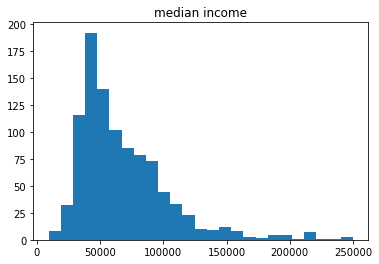

In [55]:
gdf_2.hist(column = 'median income',
        grid=False,
        bins = 25)

That's better. I can see that my prediction above about the income skew was correct. Next, I want to find the median income of census tracts that make up Zip Code 91335. Nathan's analysis looked at ADU's in this Zip Code, so I want to take a look its incomes. From a HUD Crosswalk File (https://www.huduser.gov/portal/datasets/usps_crosswalk.html), I found that the following census tracts make up Zip Code 91335:

06037132300, 06037132501, 06037131600, 06037134901, 06037131020, 06037131300, 06037131800, 06037131400, 06037131010, 06037133000, 06037132502, 06037133100, 06037131702, 06037132900, 06037131701, and 06037132700

So, I'll find those census tracts in my dataset and take the average of their median incomes.

In [56]:
gdf_2_91335 = gdf_2[(gdf_2['geoid']=='14000US06037132300') 
            | (gdf_2['geoid'] == '14000US06037132501')
            | (gdf_2['geoid'] == '14000US06037131600')
            | (gdf_2['geoid'] == '14000US06037134901')
            | (gdf_2['geoid'] == '14000US06037131020')
            | (gdf_2['geoid'] == '14000US06037131300')
            | (gdf_2['geoid'] == '14000US06037131800')
            | (gdf_2['geoid'] == '14000US06037131400')
            | (gdf_2['geoid'] == '14000US06037131010')
            | (gdf_2['geoid'] == '14000US06037133000')
            | (gdf_2['geoid'] == '14000US06037132502')
            | (gdf_2['geoid'] == '14000US06037133100')
            | (gdf_2['geoid'] == '14000US06037131702')
            | (gdf_2['geoid'] == '14000US06037132900')
            | (gdf_2['geoid'] == '14000US06037131701')
            | (gdf_2['geoid'] == '14000US06037132700')]
gdf_2_91335['median income'].mean()

65849.25

This shows me that the average median income of census tracts in this zip code is about $66,000. Now, to visualize the data, I'm going to plot it based on median income. I expect to see the high incomes in the Hollywood Hills and the low incomes in South LA, with a mix of incomes in the Valley.

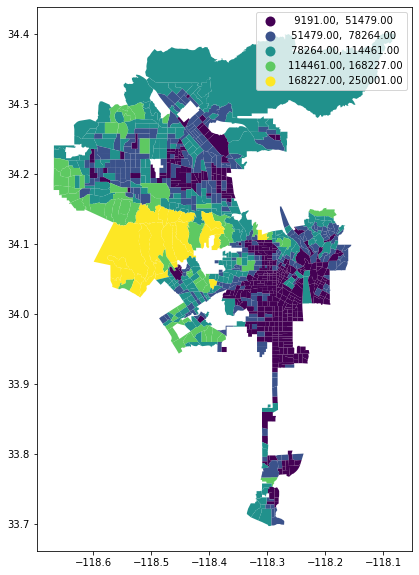

In [57]:
gdf_2.plot(figsize=(12,10),
    column = 'median income',
    legend = True,
    scheme = 'NaturalBreaks')

I was correct again, although it wasn't exactly difficult to predict. The last thing I'd like to do is add a basemap to the plot.

In [58]:
gdf_2_web_mercator = gdf_2.to_crs(epsg=3857)

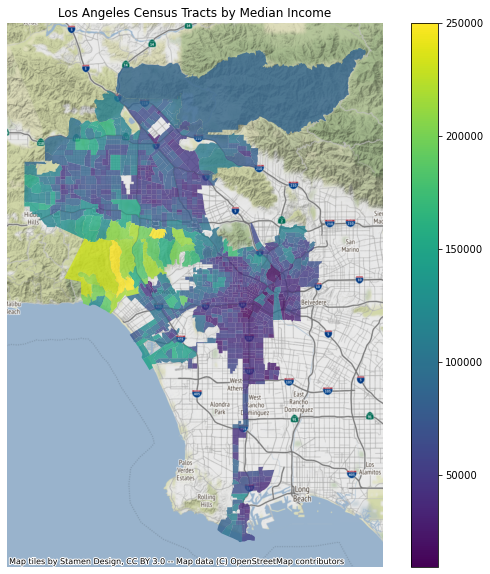

In [59]:
fig, ax = plt.subplots(figsize=(10,10))
gdf_2_web_mercator.plot(column='median income',
                      ax=ax, 
                      legend=True,
                      alpha=0.8)
ax.axis('off')
ax.set_title('Los Angeles Census Tracts by Median Income')
ctx.add_basemap(ax)

This is a nice presentation of the data that is going to help us answer our research question. This gives us a sense of where the wealthy and low-income neighborhoods are. When we combine this with our data showing where the ADU permits are, we'll be able to assess the relationship and draw conclusions.

# Data Join and Initial Analysis

In this section, we (for the first time!) join our two datasets: permitted ADUs and neighorhood income levels. We create a single geodataframe containing information from both datasets and create an initial map.

## Create a two layer map

For the first time, we now combine our two data sources. Below, we create a map showing the census blocks and permitted ADUs. For now, all the census blocks are formatted the same.

In [60]:
# get the bounding box coordinates for the permit data
minx, miny, maxx, maxy = gdf.geometry.total_bounds
print(minx)
print(maxx)
print(miny)
print(maxy)

-118.66127
-118.1593
33.71678
34.32924


## Subplots for multi-layered maps

In [61]:
gdf = gdf.to_crs(epsg=4326)
gdf_2 = gdf_2.to_crs(epsg=4326)

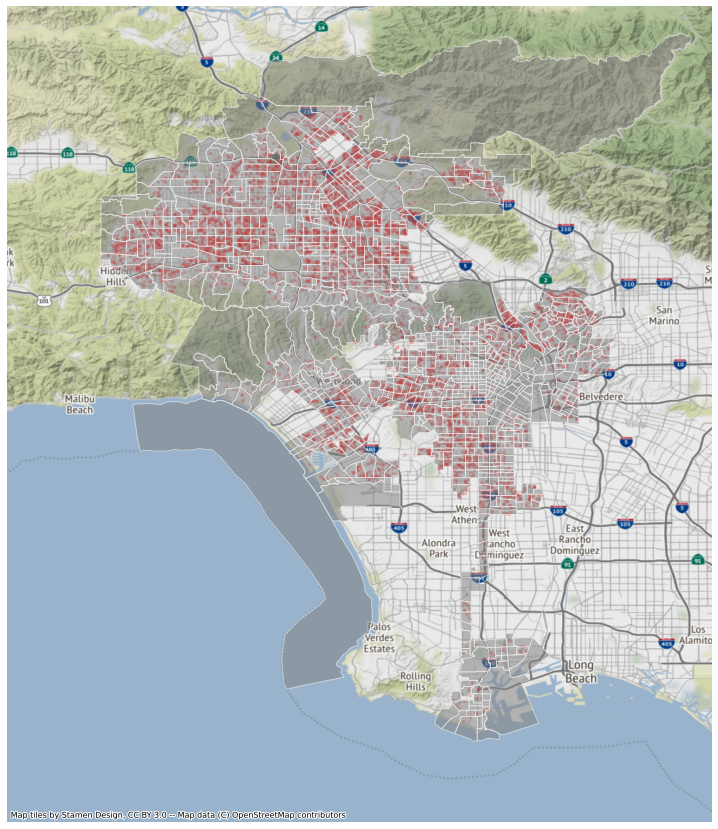

In [62]:
# set up the plot canvas with plt.subplots
fig, ax = plt.subplots(figsize=(15, 15))

# permit data
gdf.plot(ax=ax, # this also puts it in the same ax plot
            color='red',
            markersize=5,
            alpha=0.2)

# median income by census tract
gdf_2.plot(ax=ax, # this puts it in the ax plot
        color='gray', 
        edgecolor='white',
        alpha=0.5)

# use the bounding box coordinates to set the x and y limits
ax.set_xlim(minx - 0.1, maxx + 0.1) # added/substracted value is to give some margin of 1000 meters (1km) around total bounds
ax.set_ylim(miny - 0.1, maxy + 0.1)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,crs=gdf.crs.to_string())

## The spatial join

In [63]:
# Do the spatial join
gdf = gdf.to_crs(epsg=4326)
join = gpd.sjoin(gdf, gdf_2, how='left')
join.head()

,Assessor Book,Assessor Page,Assessor Parcel,Tract,Block,Lot,Reference # (Old Permit #),PCIS Permit #,Status,Status Date,Permit Type,Permit Sub-Type,Permit Category,Project Number,Event Code,initiating_office,Issue Date,Issue Day,Issue Month,Issue Year,Address Start,Address Fraction Start,Address End,Address Fraction End,Street Direction,Street Name,Street Suffix,Suffix Direction,Unit Range Start,Unit Range End,Zip_Code,Work Description,Valuation,Floor Area-L.A. Zoning Code Definition,# of Residential Dwelling Units,# of Accessory Dwelling Units,# of Stories,Contractors_Business_Name,Contractor Address,Contractor City,Contractor State,License Type,License #,Principal First Name,Principal Middle Name,Principal Last Name,License Expiration Date,Applicant First Name,Applicant Last Name,Applicant Business Name,Applicant Address 1,Applicant Address 2,Applicant Address 3,Zone,Occupancy,Floor Area-L.A. Building Code Definition,Census Tract,Council District,Latitude,Longitude,Existing Code,Proposed Code,geometry,index_right,geoid,name,median income,error,population,poperror
0,5069,2,15,TR 4713,,43,20WL05816,19014-10000-05185,Issued,3/10/2020,Bldg-Addition,1 or 2 Family Dwelling,Plan Check,,,METRO,3/10/2020,10,3,2020,1563,,1563,,S,GENESEE,AVE,,,,90019,CONVERTING OF (E) GARAGE INTO ACCESSORY DWELLI...,"50,000.00",386,0,1,1,FURER CONSTRUCTION INC,3133 ROBERTS AVE,CULVER CITY,CA,B,988604,HANSPETER,,FURER,11/30/2021,MARC,RAZO,,,,,R1R3-RG-O,,115,2169,10,34.04739,-118.36467,7,1,POINT (-118.36467 34.04739),642,14000US06037216900,"Census Tract 2169, Los Angeles, CA",89547.0,20184.0,4886.0,343.0
1,2276,18,28,TR 5822,,316,19VN04144,19016-20001-12927,Permit Finaled,10/28/2020,Bldg-Alter/Repair,1 or 2 Family Dwelling,Plan Check,,,VAN NUYS,9/20/2019,20,9,2019,14826,,14826,2-Jan,W,GREENLEAF,ST,,,,91403,Supplemental permit of 19016-20000-12927 to ch...,501,0,0,1,0,OWNER-BUILDER,,,,NA,0,,,,,JACQUELINE,ACOSTA,,6314 VAN NUYS BL.,#212,VAN NUYS CA,RE11-1,,0,1413.04,4,34.14947,-118.4565,1,1,POINT (-118.45650 34.14947),336,14000US06037141304,"Census Tract 1413.04, Los Angeles, CA",98375.0,9629.0,2995.0,271.0
2,2226,14,6,TR 20444,,6,20ON 1930,20016-10000-19416,Issued,10/27/2020,Bldg-Alter/Repair,1 or 2 Family Dwelling,Plan Check,,,METRO,10/27/2020,27,10,2020,7527,,7529,,N,RUFFNER,AVE,,,,91406,CONVERSION OF (E) ATTACHED GARAGE TO ACCESSORY...,"50,000.00",360,0,1,1,OWNER-BUILDER,,,,NA,0,,,,1/1/2022,JAVIER,VASQUES,,,,,R1-1,,0,1321.02,6,34.20732,-118.49688,1,1,POINT (-118.49688 34.20732),262,14000US06037132102,"Census Tract 1321.02, Los Angeles, CA",49838.0,12253.0,5401.0,485.0
3,2637,1,20,TR 14616,,87,19VN92737,19016-20000-10523,CofO Issued,10/31/2020,Bldg-Alter/Repair,1 or 2 Family Dwelling,Plan Check,,,VAN NUYS,4/29/2019,29,4,2019,8764,,8766,,N,RANCHITO,AVE,,,,91402,CONVERT THE (E) ATTACHED GARAGE INTO A (N) ADU...,"20,000.00",388.5,,1,,OWNER-BUILDER,,,,NA,0,,,,,NOEMI,ESPINO,,,,,R1-1,,0,1199,6,34.2294,-118.43923,1,1,POINT (-118.43923 34.22940),139,14000US06037119900,"Census Tract 1199, Los Angeles, CA",78000.0,14084.0,5245.0,401.0
4,5053,24,32,CHA'S VICTOR HALL TRACT,26,21,20ON 1938,20010-10000-02259,Issued,10/27/2020,Bldg-New,1 or 2 Family Dwelling,Plan Check,,,METRO,10/27/2020,27,10,2020,3023,,3023,,S,HALLDALE,AVE,,,,90018,NEW DETACHED ACCESSORY DWELLING UNIT PER STATE...,"44,238.00",438,,1,1,SO CAL CONSTRUCTION ENTERPRISES INC,P O BOX 96,SAN GABRIEL,CA,B,832488,GARY,JUAN,URBINA,3/31/2022,RODNEY,REDONDO,,.,.,.,R1R3-O-CPIO,,438,2221,8,34.02655,-118.30291,,1,POINT (-118.30291 34.02655),687,14000US06037222100,"Census Tract 2221, Los Angeles, CA",53864.0,12608.0,4331.0,488.0


We now have a single geodataframe (titled "join") that shows every permit, along with its census tract, that tract's median income, and that tract's population. We then create a table (permits_by_tract) showing each of the census tracts sorted by how many permits were pulled in them. Below that, we show a table of the top 20 tracts. Without a spatial component, this doesn't tell us a bunch.

In [64]:
#combining arguments (can be split up) to use joined gdf and using the FIPS code to get a count - resetting to get index
permits_by_tract = join.geoid.value_counts().rename_axis('geoid').reset_index(name='permits_count')

In [65]:
permits_by_tract.head()

,geoid,permits_count
0,14000US06037135203,53
1,14000US06037181000,52
2,14000US06037139301,51
3,14000US06037119800,49
4,14000US06037121010,48


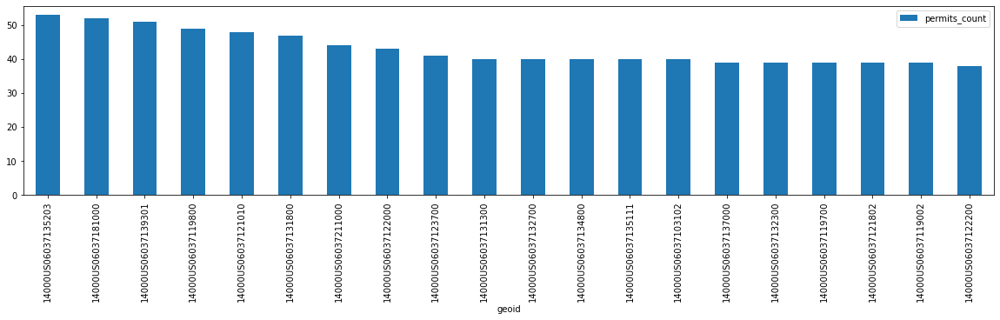

In [66]:
# make a bar chart of top 20 geographies
permits_by_tract[:20].plot.bar(figsize=(20,4),
                             x='geoid',
                             y='permits_count')

## Join the value counts back to the gdf

We want to add a spatial component, so we begin that process by joining the number of permits in each census tract to our original census tract dataset.

In [67]:
# join the summary table back to the gdf
# merge permits on gdf by census tract
gdf_2=gdf_2.merge(permits_by_tract,on='geoid')

In [68]:
gdf_2.head()

,geoid,name,median income,error,geometry,population,poperror,permits_count
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",63534.0,16806.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009...",4283.0,443.0,21
1,14000US06037101122,"Census Tract 1011.22, Los Angeles, CA",90389.0,9796.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033...",3405.0,334.0,17
2,14000US06037101210,"Census Tract 1012.10, Los Angeles, CA",44083.0,9483.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979...",6347.0,484.0,2
3,14000US06037101220,"Census Tract 1012.20, Los Angeles, CA",43713.0,4639.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859...",3702.0,276.0,12
4,14000US06037101300,"Census Tract 1013, Los Angeles, CA",81776.0,11857.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782...",3884.0,394.0,23


## Normalizing: Permits per 1000 people

Before going any further, though, we want to normalize our permit data based on population. If a census tract has twice the population of another, we don't want to give it extra credit for having more ADU permits.

In [69]:
gdf_2['permits_per_1000'] = gdf_2['permits_count']/gdf_2['population']*1000

In [70]:
gdf_2.head()

,geoid,name,median income,error,geometry,population,poperror,permits_count,permits_per_1000
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",63534.0,16806.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009...",4283.0,443.0,21,4.903105
1,14000US06037101122,"Census Tract 1011.22, Los Angeles, CA",90389.0,9796.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033...",3405.0,334.0,17,4.992658
2,14000US06037101210,"Census Tract 1012.10, Los Angeles, CA",44083.0,9483.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979...",6347.0,484.0,2,0.315110
3,14000US06037101220,"Census Tract 1012.20, Los Angeles, CA",43713.0,4639.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859...",3702.0,276.0,12,3.241491
4,14000US06037101300,"Census Tract 1013, Los Angeles, CA",81776.0,11857.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782...",3884.0,394.0,23,5.921730


In [71]:
gdf_2.sort_values(by="permits_per_1000").tail()

,geoid,name,median income,error,geometry,population,poperror,permits_count,permits_per_1000
275,14000US06037135111,"Census Tract 1351.11, Los Angeles, CA",101554.0,15716.0,"MULTIPOLYGON (((-118.61466 34.19815, -118.6136...",3313.0,360.0,40,12.073649
146,14000US06037121802,"Census Tract 1218.02, Los Angeles, CA",68083.0,11606.0,"MULTIPOLYGON (((-118.39652 34.21935, -118.3965...",3216.0,411.0,39,12.126866
6,14000US06037102103,"Census Tract 1021.03, Los Angeles, CA",76833.0,8001.0,"MULTIPOLYGON (((-118.36533 34.22870, -118.3639...",1763.0,204.0,23,13.045944
814,14000US06037980026,"Census Tract 9800.26, Los Angeles, CA",NaN,NaN,"MULTIPOLYGON (((-118.35173 34.28034, -118.3517...",26.0,18.0,1,38.461538
813,14000US06037980009,"Census Tract 9800.09, Los Angeles, CA",NaN,NaN,"MULTIPOLYGON (((-118.33707 34.14160, -118.3361...",5.0,7.0,1,200.000000


It looks like census tract 9800.09 has just 5 residents, but also an ADU. Census tract 9800.26 similarly has just 1 ADU but not many residents. We'll keep an eye on these outliers as we proceed through the data. For this assignment, I don't want to remove any data, but we may consider doing so for the final project. Next, we map a slice of the data, showing the 20 census tracts with the most ADUs permitted per person.

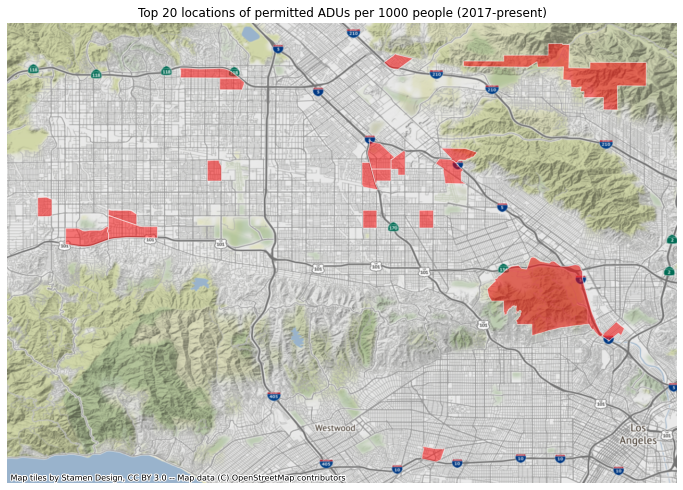

In [72]:
fig,ax = plt.subplots(figsize=(12,10))
gdf_2.sort_values(by='permits_per_1000',ascending=False)[:20].plot(ax=ax,
                                                                 color='red',
                                                                 edgecolor='white',
                                                                 alpha=0.5,legend=True)


# title
ax.set_title('Top 20 locations of permitted ADUs per 1000 people (2017-present)')

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,crs=gdf.crs.to_string())

They're (almost) all in the Valley - that's very interesting. I tend to think of the Valley as having a greater diversity of incomes; I wonder if that has anything to do with it? I'm sure our further analysis will yield more insights.

## Choropleth Map of Permits

Now we are ready to generate a choropleth map of the permitted ADUs.

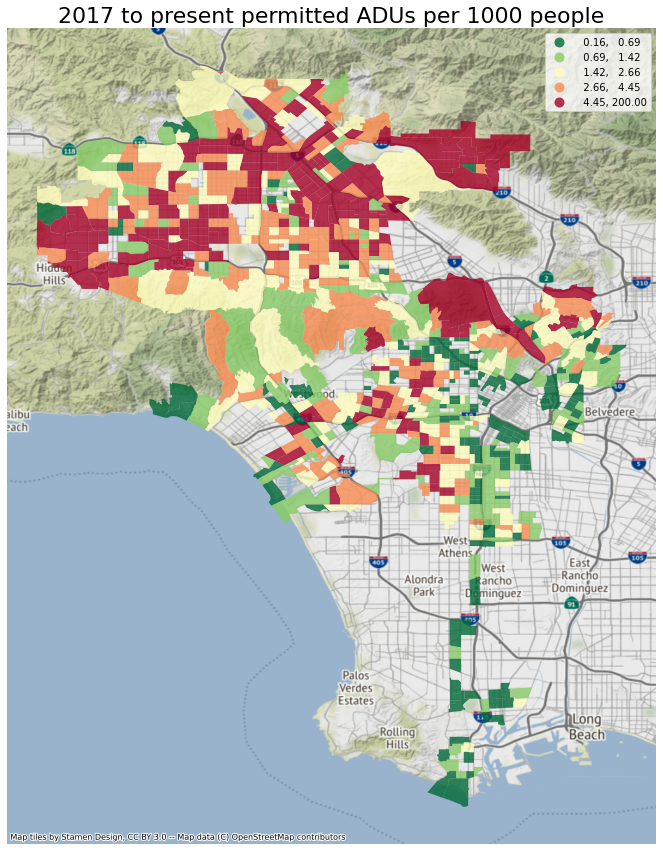

In [73]:
fig, ax = plt.subplots(figsize=(15,15))

gdf_2.plot(ax=ax,
          column='permits_per_1000',
           legend=True,
           alpha = 0.8,
           cmap='RdYlGn_r',
           scheme='quantiles')

ax.axis('off')
ax.set_title('2017 to present permitted ADUs per 1000 people',fontsize=22)
ctx.add_basemap(ax,crs=gdf.crs.to_string())

Now here is some interesting data! The trend of the most ADUs per person in the Valley continues. It looks like there are also some ADU activity clusters in West LA. South LA and East LA have less ADUs. The hills also have less ADUs.

# Spatial Autocorrelation

Now that we have connected our two datasets spatially and mapped them to show the location of permits per 1000 people by census tracts, we see that there are spatial clusters appearing primarily in the San Fernando Valley. However, we can't really back this up with statistical certainty. It's unclear if this pattern is a matter of chance. To evaluate this, we will conduct spatial autocorrelation, a process to determine to what degree an existing pattern is or is not random. We'll use the Global Moran's I statistic to help us quantify the degree to which similar geographies are clustered. 

Our tasks for this section are as follows:

- Find tendencies for spatial clustering in your data by conducting a spatial autocorrelation analysis. Our results will include a global Moran's I statistic, followed by a local spatial autocorrelation with a Moran's plot that indicates a P-value and a scatterplot with HH, HL, LH, and LL values. 
- Produce a final output in the form of a map that indicates the location of statistically significant spatial clusters.

Below, we'll walk through the steps from the spatial autocorrelation lab to accomplish these goals.

## Spatial Weights

The map directly above shows each census tract's permitted ADUs. However, we're interested to compare each tract's permitted ADUs to its neighbors. To do this, we assign spatial weights to each tract. Similar to the Week 8 lab, we'll do this using the KNN weight, where k is the number of "nearest neighbors" to count in the calculations. We'll look at the 8 nearest neighbors. 

In [74]:
# calculate spatial weight
wq =  lps.weights.KNN.from_dataframe(gdf_2,k=8)

# Row-standardization
wq.transform = 'r'

## Spatial Lag

Next, we use those row-standardized weights to calculate the spatial lag. The spatial lag is a single number per census tract that is calculated by taking the average of its 8 nearest neighbors' spatial weights. This takes into account the values from each census tract's neighbors, taking the value from each neighbor, based on spatial weight, to get a single associated lag value. We'll place this spatial lag value in a new column.

In [75]:
gdf_2['permits_per_1000_lag'] = lps.weights.lag_spatial(wq, gdf_2['permits_per_1000'])

In [76]:
gdf_2.sample(10)[['population','permits_count','permits_per_1000','permits_per_1000_lag']]

,population,permits_count,permits_per_1000,permits_per_1000_lag
404,2370.0,4,1.687764,2.287726
32,4321.0,1,0.231428,3.166084
55,2661.0,12,4.509583,3.904094
79,8735.0,18,2.060675,5.381236
260,4305.0,8,1.858304,2.731043
163,4530.0,14,3.090508,5.392467
593,3697.0,4,1.081958,0.832588
744,3245.0,2,0.616333,2.021732
613,4489.0,5,1.113834,0.996028
522,3203.0,20,6.244146,4.032034


We can now compare "permits_per_1000" to "permits_per_1000_lag". When the former value is higher, the census tract is closer to being a "diamond" - more permits than its neighbors. When the latter value is higher, it's closer to a "donut" - less permits than its neighbors.

For example, in row 522, we see that this census tract's permit per 1000 value is higher than its permit per 1000 lag value. This means that this tract is likely a diamond as its normalized permit count is higher than the average of its 8 nearest neighbors. 

## The Donut and the Diamond

Here, we want to identify census tracts that are the most "donuty" and the most "diamondy", per the description in the markdown cell above. We start by calculating the difference between permits_per_1000 and permits_per_1000_lag for each row. We then find the donut and the diamond and map them.

In [77]:
gdf_2['permit_lag_diff'] = gdf_2['permits_per_1000'] - gdf_2['permits_per_1000_lag']

In [78]:
gdf_2.sort_values(by='permit_lag_diff')

,geoid,name,median income,error,geometry,population,poperror,permits_count,permits_per_1000,permits_per_1000_lag,permit_lag_diff
365,14000US06037188100,"Census Tract 1881, Los Angeles, CA",62500.0,14197.0,"MULTIPOLYGON (((-118.27834 34.15320, -118.2776...",3918.0,440.0,18,4.594181,28.327696,-23.733515
2,14000US06037101210,"Census Tract 1012.10, Los Angeles, CA",44083.0,9483.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979...",6347.0,484.0,2,0.315110,9.425765,-9.110656
3,14000US06037101220,"Census Tract 1012.20, Los Angeles, CA",43713.0,4639.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859...",3702.0,276.0,12,3.241491,9.059968,-5.818477
151,14000US06037122122,"Census Tract 1221.22, Los Angeles, CA",41811.0,6104.0,"MULTIPOLYGON (((-118.37948 34.22330, -118.3774...",2728.0,282.0,3,1.099707,6.355258,-5.255552
286,14000US06037137501,"Census Tract 1375.01, Los Angeles, CA",92156.0,15693.0,"MULTIPOLYGON (((-118.58837 34.16640, -118.5882...",4915.0,492.0,6,1.220753,6.348656,-5.127904
...,...,...,...,...,...,...,...,...,...,...,...
733,14000US06037270300,"Census Tract 2703, Los Angeles, CA",74323.0,9943.0,"MULTIPOLYGON (((-118.37749 34.03702, -118.3774...",2542.0,217.0,27,10.621558,3.199573,7.421985
275,14000US06037135111,"Census Tract 1351.11, Los Angeles, CA",101554.0,15716.0,"MULTIPOLYGON (((-118.61466 34.19815, -118.6136...",3313.0,360.0,40,12.073649,3.360999,8.712651
6,14000US06037102103,"Census Tract 1021.03, Los Angeles, CA",76833.0,8001.0,"MULTIPOLYGON (((-118.36533 34.22870, -118.3639...",1763.0,204.0,23,13.045944,4.310464,8.735480
814,14000US06037980026,"Census Tract 9800.26, Los Angeles, CA",NaN,NaN,"MULTIPOLYGON (((-118.35173 34.28034, -118.3517...",26.0,18.0,1,38.461538,5.173605,33.287934


In [79]:
gdf_2_donut = gdf_2.sort_values(by='permit_lag_diff').head(1)
gdf_2_diamond = gdf_2.sort_values(by='permit_lag_diff').tail(1)

In [80]:
gdf_2_donut

,geoid,name,median income,error,geometry,population,poperror,permits_count,permits_per_1000,permits_per_1000_lag,permit_lag_diff
365,14000US06037188100,"Census Tract 1881, Los Angeles, CA",62500.0,14197.0,"MULTIPOLYGON (((-118.27834 34.15320, -118.2776...",3918.0,440.0,18,4.594181,28.327696,-23.733515


In [81]:
gdf_2_diamond

,geoid,name,median income,error,geometry,population,poperror,permits_count,permits_per_1000,permits_per_1000_lag,permit_lag_diff
813,14000US06037980009,"Census Tract 9800.09, Los Angeles, CA",NaN,NaN,"MULTIPOLYGON (((-118.33707 34.14160, -118.3361...",5.0,7.0,1,200.0,2.697389,197.302611


I can see that our diamond is the outlier case with one ADU and five people. This tract, unfortunately, has no median income data, so it's not too relevant to us. The donut appears to be a pretty standard census tract. To see where these are, we map them. To start, we project both the donut and diamond to WGS84 and determine their centroids to use when we map them.

In [82]:
token = 'pk.eyJ1IjoieW9obWFuIiwiYSI6IkxuRThfNFkifQ.u2xRJMiChx914U7mOZMiZw'
px.set_mapbox_access_token(token)

In [83]:
gdf_2_donut = gdf_2_donut.to_crs('epsg:4326')

minx, miny, maxx, maxy = gdf_2_donut.geometry.total_bounds
center_lat_donut = (maxy-miny)/2+miny
center_lon_donut = (maxx-minx)/2+minx

In [84]:
gdf_2_diamond = gdf_2_diamond.to_crs('epsg:4326')

minx, miny, maxx, maxy = gdf_2_diamond.geometry.total_bounds
center_lat_diamond = (maxy-miny)/2+miny
center_lon_diamond = (maxx-minx)/2+minx

Now we have what we need to map both census tracts! We do so using a choropleth map.

In [85]:
px.choropleth_mapbox(gdf_2_donut, 
                     geojson=gdf_2_donut.geometry, 
                     locations=gdf_2_donut.index, 
                     mapbox_style="satellite-streets",
                     zoom=14, 
                     center = {"lat": center_lat_donut, "lon": center_lon_donut},
                     hover_data=['permits_count','permits_per_1000','permits_per_1000_lag'],
                     opacity=0.4,
                     title='The Donut')

In [86]:
px.choropleth_mapbox(gdf_2_diamond, 
                     geojson=gdf_2_diamond.geometry, 
                     locations=gdf_2_diamond.index, 
                     mapbox_style="satellite-streets",
                     zoom=12, 
                     center = {"lat": center_lat_diamond, "lon": center_lon_diamond},
                     hover_data=['permits_count','permits_per_1000','permits_per_1000_lag'],
                     opacity=0.4,
                     title='The Diamond')

Well - so much for my statement above that the donut seems to be a pretty standard census tract! It is, but its spatial lag is so high because it borders our diamond, which again, has a very small population sample size. This doesn't tell us all too much, but when we look at the entire spatial lag map, more meaningful trends will appear.

## Spatial Lag Map

Now we will map the entire dataframe using the newly created spatial lag column.

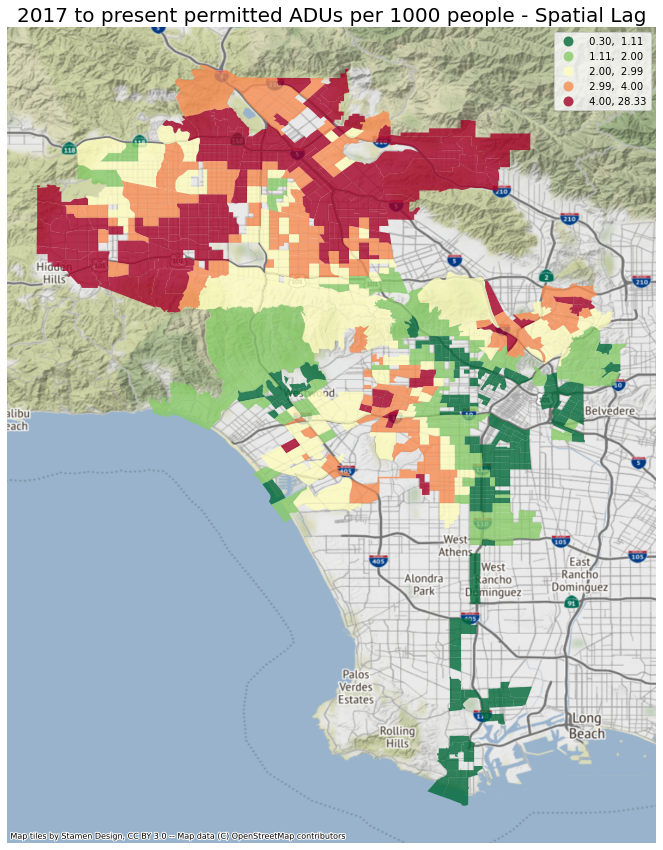

In [87]:
# use subplots that make it easier to create multiple layered maps
fig, ax = plt.subplots(figsize=(15, 15))

# spatial lag choropleth
gdf_2.plot(ax=ax,
         figsize=(15,15),
         column='permits_per_1000_lag',
         legend=True,
         alpha=0.8,
         cmap='RdYlGn_r',
         scheme='quantiles')

ax.axis('off')
ax.set_title('2017 to present permitted ADUs per 1000 people - Spatial Lag',fontsize=20)

ctx.add_basemap(ax,crs=gdf.crs.to_string())

Compared to our previous map, "2017 to present permitted ADUs per 1000 people," this map accounts for the spatial lag and the spatial clusters of permit activity become much clearer. We see some isolated clusters of significant activity that appear to be occurring in LA's Mid-City area, Eagle Rock and parts of the city that are just east of Inglewood or just west of Glendale. However, most of the activity appears to be concentrated throughout the San Fernando Valley. 

This contrast between the two maps can be seen more clearly in a side-by-side comparison below.

## Side-by-side maps

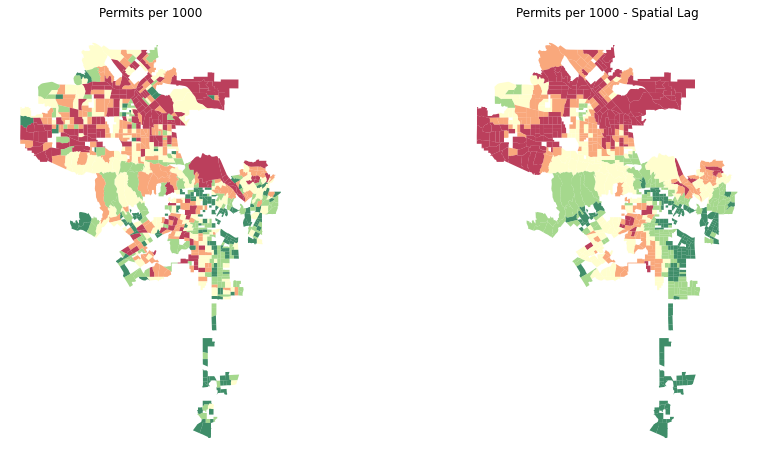

In [88]:
# create the 1x2 subplots
fig, ax = plt.subplots(1, 2, figsize=(15, 8))

# two subplots produces ax[0] (left) and ax[1] (right)

# regular count map on the left
gdf_2.plot(ax=ax[0], # this assigns the map to the left subplot
         column='permits_per_1000', 
         cmap='RdYlGn_r', 
         scheme='quantiles',
         k=5, 
         edgecolor='white', 
         linewidth=0, 
         alpha=0.75, 
           )


ax[0].axis("off")
ax[0].set_title("Permits per 1000")

# spatial lag map on the right
gdf_2.plot(ax=ax[1], # this assigns the map to the right subplot
         column='permits_per_1000_lag', 
         cmap='RdYlGn_r', 
         scheme='quantiles',
         k=5, 
         edgecolor='white', 
         linewidth=0, 
         alpha=0.75
           )

ax[1].axis("off")
ax[1].set_title("Permits per 1000 - Spatial Lag")

plt.show()

## Interactive spatial lag satellite map

Now we will attempt to plot the spatial lag column of the dataset on an interactive satellite map, so we can better contextualize where these spatial clusters are occurring in the city of LA. By zooming in, we can confirm exactly where these clusters are happening, rather than just guessing "west of Glendale" like we did previously.

In [89]:
# interactive version needs to be in WGS84
gdf_2_web = gdf_2.to_crs('EPSG:4326')

In [90]:
# what's the centroid? (center lat, center long)
minx, miny, maxx, maxy = gdf_2_web.geometry.total_bounds
center_lat_gdf_2_web = (maxy-miny)/2+miny
center_lon_gdf_2_web = (maxx-minx)/2+minx

In [91]:
# some stats
gdf_2_web.permits_per_1000_lag.describe()

count    815.000000
mean       2.727261
std        1.909338
min        0.302644
25%        1.285729
50%        2.518683
75%        3.654635
max       28.327696
Name: permits_per_1000_lag, dtype: float64

In [92]:
# grab the median
median = gdf_2_web.permits_per_1000_lag.median()

In [93]:
#this is complex, so Yoh is available to meet in OH if we want to pursue something like this map

fig = px.choropleth_mapbox(gdf_2_web, 
                     geojson=gdf_2_web.geometry, # the geometry column
                     locations=gdf_2_web.index, # the index
                     mapbox_style="satellite-streets",
                     zoom=9, 
                     color='permits_per_1000_lag',
                     color_continuous_scale='RdYlGn_r',
                     color_continuous_midpoint =median, # put the median as the midpoint
                     range_color =(0,median*2),
                     hover_data=['permits_count','permits_per_1000','permits_per_1000_lag'],
                     center = {"lat": center_lat_gdf_2_web, "lon": center_lon_gdf_2_web},
                     opacity=0.8,
                     width=1000,
                     height=800,
                     labels={
                             'permits_per_1000_lag':'Permits per 1000 (Spatial Lag)',
                             'permits_per_1000':'Permits per 1000',
                     })
fig.update_traces(marker_line_width=0.1, marker_line_color='white')
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

Great! The zoom and pan features are very helpful and provide a lot more context. For example, looking at the cluster "just east of Inglewood," we can zoom to see that the specific neighborhoods these tracts sit within are Hyde Park and the northern edge of Morningside Park.  



## Moran's Plot

We now want to quantify the degree of the spatial correlation. We'll start by calculating the Moran's I value below.

In [94]:
y = gdf_2.permits_per_1000
moran = Moran(y, wq)
moran.I

0.04701339961456352

From lab, we know that the Moran's I value is essentially the value of the slope of the scatterplot of our "permits per 1000" and "permits per 1000 spatial lag" columns. It indicates whether or not we have a positive or negative autocorrelation. Our value was calculated to be roughly 0.05.

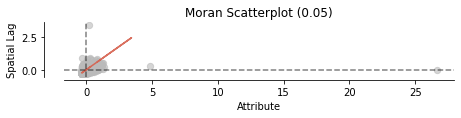

In [95]:
#MOrans I value is the slope - red line going through
fig, ax = moran_scatterplot(moran, aspect_equal=True)
plt.show()

Because the line shows a positive slope, this indicates that either high values are close to high values and/or low values are close to low values. What does this all mean, though? What we're trying to determine is how likely it is that the clusters we are seeing are occurring due to random chance. 

This process randomizes our census tracts 999 times. We then can determine whether we can reject the hypothesis that our current distribution of data is random. 

/opt/conda/lib/python3.8/site-packages/splot/_viz_esda_mpl.py:47: MatplotlibDeprecationWarning:


The set_smart_bounds function was deprecated in Matplotlib 3.2 and will be removed two minor releases later.

/opt/conda/lib/python3.8/site-packages/splot/_viz_esda_mpl.py:48: MatplotlibDeprecationWarning:


The set_smart_bounds function was deprecated in Matplotlib 3.2 and will be removed two minor releases later.



(<Figure size 504x504 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f645dda44c0>)

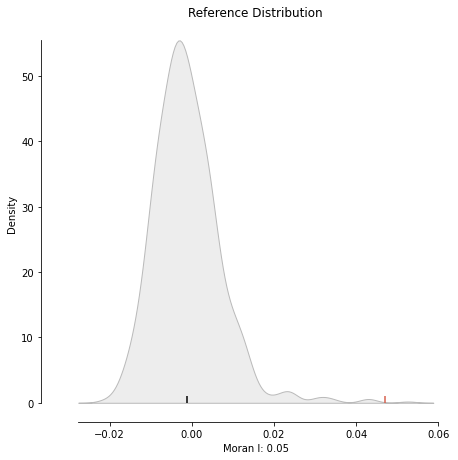

In [96]:
plot_moran_simulation(moran,aspect_equal=False)

The simulation we ran produced the graph above. The red dot indicates our Moran's I value (0.04701). The accompanying distribution represents the possibility of 999 permutations of randomization. Our Moran's I value is relatively far away from this distribution, but nowhere near as far as the value was during lab. It's difficult for me to confidently say if we are outside of the realm of possibility that this is "occurring by chance." Funny to be doing this course while also learning stats for the first time.. 

Let's calculate the p-value and compare this to our alpha (0.05) to see if we can reject the null hypothesis. We'll calculate the Moran's p-value below.

In [97]:
moran.p_sim

0.002

The p-value calculated was 0.004. From this, we know that there is a 0.4% chance that our findings occurred randomly. Since the alpha value is typically 0.05 and our p-value is well below this value, we can reject the null hypothesis that the map is random. In other words, we conclude that the map displays more spatial pattern than expected if the values had been randomly allocated to a location.

After revisting the lab recording, I hope am understanding this correctly...

## Local Spatial Autocorrelation & Moran Local Scatterplot

In the previous cells, we determined that there is a positive spatial autocorrelation and that this is not occurring at random in a global sense. We'll conduct a local spatial autocorrelation to determine exactly where these clusters are happening. To do so, we'll use "Local Indicators of Spatial Assocation (LISA)". This tool classifies areas into the following four groups: 

- HH: high permit rate geographies near other high permit rate neighbors 
- LL: low permit rate geographies near other low permit rate neighbors 
- LH (donuts): low permit rate geographies surrounded by high permit rate neighbors
- HL (diamonds): high permit rate geographies surrounded by low permit rate neighbors

In [98]:
# calculate local moran values
lisa = esda.moran.Moran_Local(y, wq)

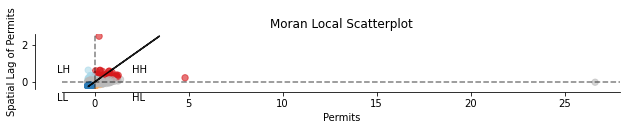

In [99]:
# Plot
fig,ax = plt.subplots(figsize=(10,15))

moran_scatterplot(lisa, ax=ax, p=0.05)
ax.set_xlabel("Permits")
ax.set_ylabel('Spatial Lag of Permits')

# add some labels
plt.text(2, 0.5, "HH", fontsize=10)
plt.text(2, -1, "HL", fontsize=10)
plt.text(-2, .5, "LH", fontsize=10)
plt.text(-2, -1, "LL", fontsize=10)
plt.show()

This scatterplot is very similar to the one we were looking at in 4.7 Moran's Plot. The permits are along the x-axis and the spatial lag of permits are along the y-axis. However, now it assigns colors to the four categories: HH (red), LL (blue), LH (light blue), and HL (yellow). We've assigned the pvalue to be 0.05, so we know that the colored census tracts are statistically significant at a pvalue of 0.05. 

## Spatial Autocorrelation Map

We will now map the information we displayed above in our Moran Local Scatterplot.

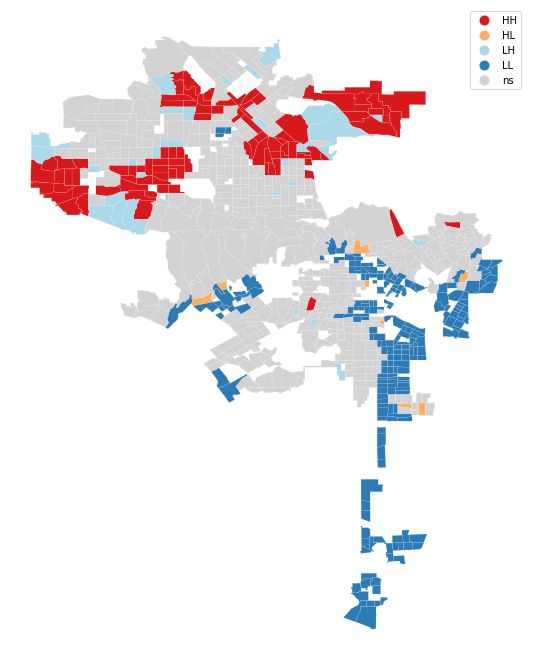

In [100]:
fig, ax = plt.subplots(figsize=(14,12))
lisa_cluster(lisa, gdf_2, p=0.05, ax=ax)
plt.show()

This is interesting because some of the tracts that had a red fill in our earlier maps have switched to a light blue. For example, if we look at the census tracts east of Inglewood in Hyde Park / Morningside Park, these now have light blue fills, which indicates that they are "LH," or low permit rate geographies surrounded by high permit rate neighbors (donuts). 

Lastly, we'll do a side-by-side map looking at different p-values. The left map will include a p-value of 0.05. The right map will include a lower p-value of 0.01, which will show clusters of permit activity with even higher statistical significance. 

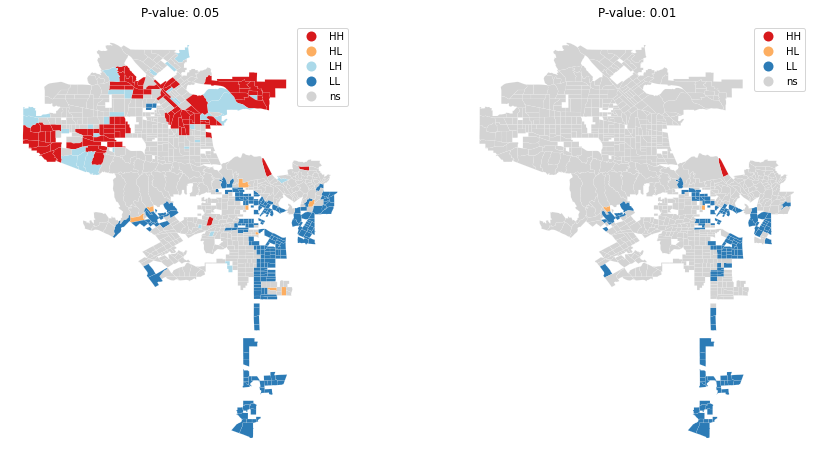

In [101]:
# create the 1x2 subplots
fig, ax = plt.subplots(1, 2, figsize=(15, 8))

# regular count map on the left
lisa_cluster(lisa, gdf_2, p=0.05, ax=ax[0])

ax[0].axis("off")
ax[0].set_title("P-value: 0.05")

# spatial lag map on the right
lisa_cluster(lisa, gdf_2, p=0.01, ax=ax[1])
ax[1].axis("off")
ax[1].set_title("P-value: 0.01")

plt.show()

This has been an interesting exercise. It's helpful to be able to pinpoint statistically significant clusters of activity in the city and analyze them through our four categories: HH, HL, LH and LL. Regarding next steps, it's likely that we will want to take a closer look at these census tracts' household median incomes and see if we are noticing any patterns. 

Collaborative: Sections 1 - 3.3

Bryan: Sections 3.4 - 4.3

Nathan: Sections 4.4 - 4.9